In [1]:
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
from pyspark.sql import SparkSession
from pyspark.mllib.feature import StandardScaler, PCA
from pyspark.mllib.stat import Statistics
from pyspark.ml.feature import VectorAssembler
from pyspark.sql.functions import from_unixtime, year
import findspark
findspark.init()
from pyspark.sql.functions import sum, when, col
import pyspark


Indagando los datasets, dimensionalidad, columnas relacionales y tratamiento de las mismas.

In [2]:
import os
os.environ["JAVA_HOME"] = "C:\Java\jdk-18.0.1.1"

In [3]:
spark = SparkSession.builder.appName("ensayo").getOrCreate()

In [4]:
#spark.stop()

In [5]:
path = "D:\KDG\Henry\LABS\PF\Python_Datasets_gmaps_reviews.parquet"
r_gmaps = spark.read.parquet(path)
r_gmaps = r_gmaps.withColumn("datetime", from_unixtime(col("time") / 1000).cast("timestamp")).withColumn("año", year("datetime"))
r_gmaps = r_gmaps.filter(col("año") >= 2018)


In [6]:
path = "D:\KDG\Henry\LABS\PF\Python_gmaps_metada.parquet"
meta_gmaps = spark.read.parquet(path)


In [7]:
meta_gmaps.printSchema()

root
 |-- name: string (nullable = true)
 |-- address: string (nullable = true)
 |-- gmap_id: string (nullable = true)
 |-- description: string (nullable = true)
 |-- latitude: double (nullable = true)
 |-- longitude: double (nullable = true)
 |-- category: array (nullable = true)
 |    |-- element: string (containsNull = true)
 |-- avg_rating: double (nullable = true)
 |-- num_of_reviews: long (nullable = true)
 |-- price: string (nullable = true)
 |-- hours: array (nullable = true)
 |    |-- element: array (containsNull = true)
 |    |    |-- element: string (containsNull = true)
 |-- MISC: struct (nullable = true)
 |    |-- Accessibility: array (nullable = true)
 |    |    |-- element: string (containsNull = true)
 |    |-- Activities: array (nullable = true)
 |    |    |-- element: string (containsNull = true)
 |    |-- Amenities: array (nullable = true)
 |    |    |-- element: string (containsNull = true)
 |    |-- Atmosphere: array (nullable = true)
 |    |    |-- element: string

In [8]:
#print((r_gmaps.count(), len(r_gmaps.columns)))

In [9]:
meta_gmaps.select("description").show()

+--------------------+
|         description|
+--------------------+
|                null|
|                null|
|                null|
|                null|
|                null|
|                null|
|                null|
|                null|
|                null|
|                null|
|                null|
|                null|
|                null|
|                null|
|                null|
|                null|
|Chain selling int...|
|                null|
|                null|
|                null|
+--------------------+
only showing top 20 rows



In [10]:

# Define las columnas en las que deseas contar los valores iguales a cero
columns_to_count_zero = ['rating']

# Calcula la suma de valores iguales a cero en cada columna
zero_counts = [sum(when(col(c) == 0, 1).otherwise(0)).alias(c) for c in columns_to_count_zero]
r_gmaps.select(zero_counts).show()


+------+
|rating|
+------+
|     0|
+------+



In [11]:
columns_to_count_greater_than_5 = ['rating']
greater_than_5_counts = [sum(when(col(c) > 5, 1).otherwise(0)).alias(c) for c in columns_to_count_greater_than_5]
r_gmaps.select(greater_than_5_counts).show()

+------+
|rating|
+------+
|     0|
+------+



In [12]:
meta_gmaps.select("address").show(truncate = False)

+------------------------------------------------------------------------------------------------------+
|address                                                                                               |
+------------------------------------------------------------------------------------------------------+
|Porter Pharmacy, 129 N Second St, Cochran, GA 31014                                                   |
|City Textile, 3001 E Pico Blvd, Los Angeles, CA 90023                                                 |
|San Soo Dang, 761 S Vermont Ave, Los Angeles, CA 90005                                                |
|Nova Fabrics, 2200 E 11th St, Los Angeles, CA 90021                                                   |
|Nobel Textile Co, 719 E 9th St, Los Angeles, CA 90021                                                 |
|Matrix International Textiles, 1363 S Bonnie Beach Pl, Commerce, CA 90023                             |
|Vons Chicken, 12740 La Mirada Blvd, La Mirada, CA 9063

In [16]:
parquet_path = "D:\KDG\Henry\LABS\PF\gmaps_filtrado_joined_2"
df = spark.read.option("mergeSchema", "true").parquet(parquet_path)

In [17]:
csv_output_path = "D:/KDG\Henry/LABS/PF/n"
df.coalesce(1).write.option("header", "true").parquet(csv_output_path, mode="overwrite")

In [19]:
path = "D:/KDG/Henry/LABS/PF/n/gmaps_joined_filtrado.parquet"
meta_gmaps = spark.read.parquet(path)

In [20]:
print((meta_gmaps.count(), len(meta_gmaps.columns)))

(3128157, 22)


In [21]:
meta_gmaps.select("exploded_category").distinct().show()


+--------------------+
|   exploded_category|
+--------------------+
|   Brunch restaurant|
|    Pizza restaurant|
|    Greek restaurant|
|                 Bar|
|          Donut shop|
|Breakfast restaurant|
|New American rest...|
|         Coffee shop|
|    Sushi restaurant|
|Health food resta...|
|Southern restaura...|
|   Indian restaurant|
| American restaurant|
|Fast food restaurant|
|               Pizza|
|              Bistro|
|     Thai restaurant|
|          Juice shop|
|       Sandwich shop|
|  British restaurant|
+--------------------+
only showing top 20 rows



In [22]:
from pyspark.sql.functions import countDistinct
meta_gmaps.select(countDistinct("gmap_id")).show()

+-----------------------+
|count(DISTINCT gmap_id)|
+-----------------------+
|                  87423|
+-----------------------+



In [25]:
meta_gmaps.select("us_state","state_name").show()

+--------+--------------+
|us_state|    state_name|
+--------+--------------+
|      TX|         Texas|
|      NY|      New York|
|      WA|    Washington|
|      OH|          Ohio|
|      SC|South Carolina|
|      OH|          Ohio|
|      NJ|    New Jersey|
|      MT|       Montana|
|      NY|      New York|
|      MO|      Missouri|
|      TX|         Texas|
|      TX|         Texas|
|      NY|      New York|
|      IL|      Illinois|
|      MO|      Missouri|
|      NJ|    New Jersey|
|      PA|  Pennsylvania|
|      NV|        Nevada|
|      NE|      Nebraska|
|      IL|      Illinois|
+--------+--------------+
only showing top 20 rows



#### Google Maps

In [ ]:
#Google_Earth
r_Alabama1 = pd.read_json("D:/KDG/Henry/LABS/PF/Google-Maps/reviews-estados/review-Alabama/1.json", encoding = "utf-8", lines = True)
r_Alabama2 = pd.read_json("D:/KDG/Henry/LABS/PF/Google-Maps/reviews-estados/review-Alabama/11.json", encoding = "utf-8", lines = True)

In [ ]:
r_Alabama1.shape

(150000, 8)

In [ ]:
def time_to_date(dataframe):
    dataframe["date"] = pd.to_datetime(dataframe["time"], unit='ms')
    dataframe["date"] = dataframe["date"].dt.strftime("%Y-%m-%d")
    dataframe["date"] = pd.to_datetime(dataframe["date"])
    return dataframe
time_to_date(r_Alabama1)
time_to_date(r_Alabama2)

,user_id,name,time,rating,text,pics,resp,gmap_id,date
0,1.116430e+20,Chris and Shea Tolbert,1542773927242,5,None,None,None,0x88882a58884a0507:0x3bdeae3983aec4dc,2018-11-21
1,1.179291e+20,clint walker,1549501934566,3,None,None,None,0x88882a58884a0507:0x3bdeae3983aec4dc,2019-02-07
2,1.130570e+20,Beth Box,1545440036434,1,None,None,None,0x88882a58884a0507:0x3bdeae3983aec4dc,2018-12-22
3,1.051583e+20,Todd Beasley,1530583141411,5,None,None,None,0x88882a58884a0507:0x3bdeae3983aec4dc,2018-07-03
4,1.139799e+20,brandi hunter,1483573068099,4,None,None,None,0x88882a58884a0507:0x3bdeae3983aec4dc,2017-01-04
...,...,...,...,...,...,...,...,...,...
149995,1.155007e+20,Tabetha Hall,1593285812146,5,We really had a great shopping experience! As ...,[{'url': ['https://lh5.googleusercontent.com/p...,None,0x8889b57e39ea437b:0xe1fc31086a8e39a9,2020-06-27
149996,1.070816e+20,Melissa Johnson,1613173099331,5,Jessica was super helpful and kind. She led us...,None,None,0x8889b57e39ea437b:0xe1fc31086a8e39a9,2021-02-12
149997,1.112208e+20,Blake Barnwell,1615995884765,5,"Best place to find western boots, cowboy hats,...",None,None,0x8889b57e39ea437b:0xe1fc31086a8e39a9,2021-03-17
149998,1.099382e+20,Danny Cassels,1616481924228,4,Rediculas selection of boots .my favorite is t...,None,None,0x8889b57e39ea437b:0xe1fc31086a8e39a9,2021-03-23


In [ ]:
print("minimo",r_Alabama1.date.min())
print("maximo",r_Alabama1.date.max())

minimo 2008-08-25 00:00:00
maximo 2021-09-09 00:00:00


In [ ]:
print("minimo",r_Alabama2.date.min())
print("maximo",r_Alabama2.date.max())

minimo 2009-02-02 00:00:00
maximo 2021-05-19 00:00:00


Se consolidó haciendo uso de Google CLoud Services todas las reviews de todos los estados en un archivo parquet, el mismo tiene 89 millones de registros. Aabajo se carga este mismo archivo y se ve la dimensión inicial vs la dimensión del archivo depurando los años.

In [ ]:
reviews_total_Estados = spark.read.parquet("D:\KDG\Henry\LABS\PF\Python_Datasets_gmpas_reviews.parquet")

In [ ]:
reviews_total_Estados = reviews_total_Estados.withColumn("timestamp", (juanB["time"] / 1000).cast("timestamp"))
reviews_total_Estados = reviews_total_Estados.withColumn("year", year(juanB["timestamp"]))
unique_years = reviews_total_Estados.select("year").distinct()
filtered_df = reviews_total_Estados.filter(juanB["year"] >= 2018)
filtered_df = filtered_df.drop("pics")
filtered_df = filtered_df.drop("resp")
filtered_df = filtered_df.drop("names")
print((filtered_df.count(), len(filtered_df.columns)))

#### Metadata-Sitios

In [ ]:
metadata_sitios = {}

for i in range(1, 8):
    nombre = "D:/KDG/Henry/LABS/PF/Google-Maps/metadata-sitios/"f"{i}.json"
    try:
        df = pd.read_json(nombre,encoding = "utf-8", lines = True)

        # Agregar el DataFrame al diccionario con una clave que sea el nombre del archivo sin la extensión
        metadata_sitios[f"df_{i}"] = df
    except FileNotFoundError:
        print(f"El archivo {nombre} no fue encontrado.")

In [ ]:
total_filas=0
for i in range(1,8):
    n_filas=metadata_sitios[f"df_{i}"].shape[0]
    total_filas += n_filas
    print(f"Tamaño dataframe {i}", metadata_sitios[f"df_{i}"].shape)
print("El total de registros es de",total_filas)

Tamaño dataframe 1 (275001, 15)
Tamaño dataframe 2 (275001, 15)
Tamaño dataframe 3 (275001, 15)
Tamaño dataframe 4 (275001, 15)
Tamaño dataframe 5 (275001, 15)
Tamaño dataframe 6 (275001, 15)
Tamaño dataframe 7 (275001, 15)
El total de registros es de 1925007


##### Valores Nulos y Ceros

In [ ]:
resultados = {'dataframe': [], 'Nulos': [], 'Ceros': []}
for i in range(1,8):
    df = metadata_sitios[f"df_{i}"] 
    nulos = df.isnull().sum().sum()
    ceros = (df == 0).sum().sum()
    
    resultados['dataframe'].append(f"df_{i}")
    resultados['Nulos'].append(nulos)
    resultados['Ceros'].append(ceros)
df_resultados = pd.DataFrame(resultados)
print(df_resultados)

  dataframe   Nulos  Ceros
0      df_1  814017      2
1      df_2  806362      5
2      df_3  795653      1
3      df_4  779471      0
4      df_5  765571      0
5      df_6  749425      5
6      df_7  725211      1


In [ ]:
consolidado = pd.DataFrame(columns=["category"])
for i in range(1, 8):
        categorias_ex = metadata_sitios[f"df_{i}"].explode("category", ignore_index=True)
        consolidado = pd.concat([consolidado, categorias_ex], ignore_index=True)
print("Numero de categorías unicas:",consolidado["category"].nunique())
print(consolidado["category"].value_counts())
consolidado["category"].value_counts().to_csv("Categorías_gmaps.csv", encoding="utf-8")

Numero de categorías unicas: 4372
category
Service establishment    56134
Restaurant               47030
Auto repair shop         46145
Beauty salon             42216
Gas station              40080
                         ...  
Hobbies                      1
Norwegian restaurant         1
Canopy                       1
Army                         1
Velodrome                    1
Name: count, Length: 4372, dtype: int64


Se extraen las categorías únicas de los sitios de Google Earth con el objetivo de realizar la comparación con las categorías de Yelp y además revisar categorías relacionadas que no sea "Restaurant" pero que sean del interés del estudio, como "Bakery", "Fast Food Restaurant", "Food Service", "Seafood", "Indian Food" entre otros.
Se identificaron 50 categorías diferentes a "Restaurants" pero que muchas entran dentro de la categoría de restaurantes y deben ser incluídas en el estudio.

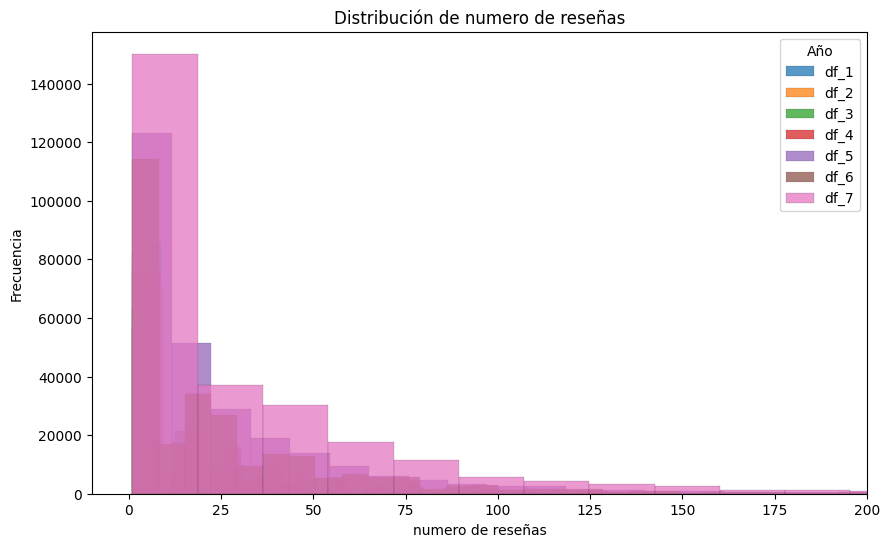

In [ ]:
ig, ax = plt.subplots(figsize=(10, 6))

# Supongamos que dataframes_por_año es un diccionario con DataFrames para diferentes años
# Iterar a través de los DataFrames y agregar sus distribuciones al gráfico
for df, dataframe in metadata_sitios.items():
    sns.histplot(data=dataframe["num_of_reviews"], bins = 550,ax=ax, label=str(df))

# Establecer etiquetas y título
ax.set_xlabel("numero de reseñas")
ax.set_ylabel("Frecuencia")
ax.set_title("Distribución de numero de reseñas")

# Mostrar una leyenda
ax.legend(title="Año")

plt.xlim(-10, 200)
plt.show()

Se observa que la mayoría de negocios tiene menos de 40 reseñas, pero la gran concentración de número de reseñas por negocio está por debajo de 25 reseñas.

Visualización de mapa de los negocios y el ingreso promedio.

In [ ]:
fig  = px.scatter_mapbox(metadata_sitios["df_1"], lon = metadata_sitios["df_1"]["longitude"], lat = metadata_sitios["df_1"]["latitude"], color = metadata_sitios["df_1"]["avg_rating"] , size = metadata_sitios["df_1"]["num_of_reviews"])

fig.update_layout(mapbox_style = "open-street-map")
fig.show()

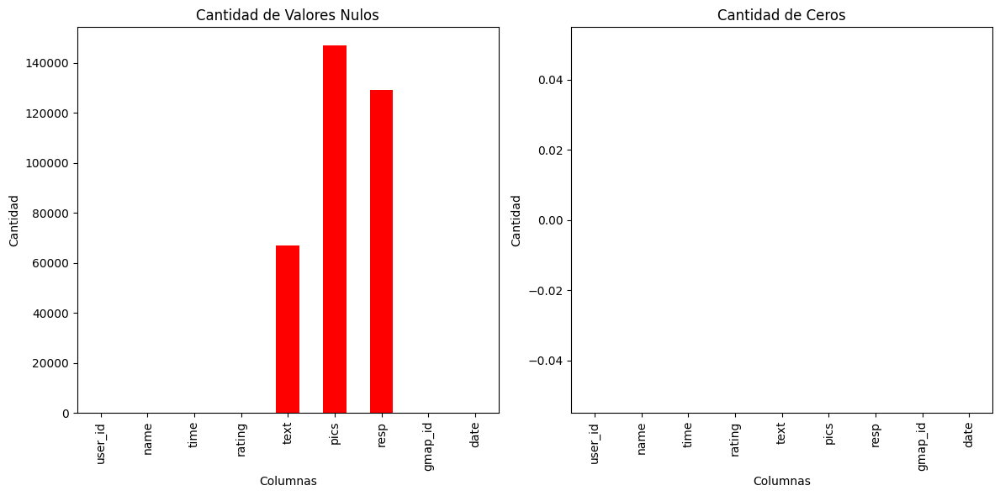

In [ ]:
'''valores nulos y ceros de r_Alabama1'''
nulos = r_Alabama1.isnull().sum()
ceros = (r_Alabama1 == 0).sum()

etiquetas = nulos.index
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
nulos.plot(kind="bar", color="red", ax=ax1)
ax1.set_title("Cantidad de Valores Nulos")
ax1.set_xlabel("Columnas")
ax1.set_ylabel("Cantidad")
ceros.plot(kind="bar", color="blue", ax=ax2)
ax2.set_title("Cantidad de Ceros")
ax2.set_xlabel("Columnas")
ax2.set_ylabel("Cantidad")
plt.tight_layout()
plt.show()

#### Yelp

In [ ]:
#YELP
checkin = pd.read_json("D:/KDG/Henry/LABS/PF/Yelp/checkin.json", encoding = "utf-8", lines = True)
tip = pd.read_json("D:/KDG/Henry/LABS/PF/Yelp/tip.json", encoding = "utf-8", lines = True)


In [ ]:
users.shape

(2105597, 22)

In [ ]:
users = pd.read_parquet("D:/KDG/Henry/LABS/PF/Yelp/user.parquet", engine= "pyarrow")

In [ ]:
bussiness.shape

(150346, 28)

In [ ]:
bussiness = pd.read_pickle("D:/KDG/Henry/LABS/PF/Yelp/business.pkl")

In [ ]:
bussiness.head(1)

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,...,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,NaN,93101,34.426679,-119.711197,5.0,7,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##### Reviews .json

In [ ]:
review = spark.read.json("D:/KDG/Henry/LABS/PF/Yelp/review.json")


In [ ]:
review.printSchema()

root
 |-- business_id: string (nullable = true)
 |-- cool: long (nullable = true)
 |-- date: string (nullable = true)
 |-- funny: long (nullable = true)
 |-- review_id: string (nullable = true)
 |-- stars: double (nullable = true)
 |-- text: string (nullable = true)
 |-- useful: long (nullable = true)
 |-- user_id: string (nullable = true)



In [ ]:
#Buscando Valores Faltantes
from pyspark.sql.functions import col, count, isnan, when
review.select([count(when(col(c).isNull(),c)).alias(c) for c in review.columns]).show()

+-----------+----+----+-----+---------+-----+----+------+-------+
|business_id|cool|date|funny|review_id|stars|text|useful|user_id|
+-----------+----+----+-----+---------+-----+----+------+-------+
|          0|   0|   0|    0|        0|    0|   0|     0|      0|
+-----------+----+----+-----+---------+-----+----+------+-------+



In [ ]:
print((review.count(), len(review.columns)))

(6990280, 9)


In [ ]:
review.describe(["stars"]).show()

+-------+------------------+
|summary|             stars|
+-------+------------------+
|  count|           6990280|
|   mean|  3.74858374771826|
| stddev|1.4787045052556855|
|    min|               1.0|
|    max|               5.0|
+-------+------------------+



In [ ]:
checkin.head(3)

,business_id,date
0,---kPU91CF4Lq2-WlRu9Lw,"2020-03-13 21:10:56, 2020-06-02 22:18:06, 2020..."
1,--0iUa4sNDFiZFrAdIWhZQ,"2010-09-13 21:43:09, 2011-05-04 23:08:15, 2011..."
2,--30_8IhuyMHbSOcNWd6DQ,"2013-06-14 23:29:17, 2014-08-13 23:20:22"


In [ ]:
tip.head(5)

,user_id,business_id,text,date,compliment_count
0,AGNUgVwnZUey3gcPCJ76iw,3uLgwr0qeCNMjKenHJwPGQ,Avengers time with the ladies.,2012-05-18 02:17:21,0
1,NBN4MgHP9D3cw--SnauTkA,QoezRbYQncpRqyrLH6Iqjg,They have lots of good deserts and tasty cuban...,2013-02-05 18:35:10,0
2,-copOvldyKh1qr-vzkDEvw,MYoRNLb5chwjQe3c_k37Gg,It's open even when you think it isn't,2013-08-18 00:56:08,0
3,FjMQVZjSqY8syIO-53KFKw,hV-bABTK-glh5wj31ps_Jw,Very decent fried chicken,2017-06-27 23:05:38,0
4,ld0AperBXk1h6UbqmM80zw,_uN0OudeJ3Zl_tf6nxg5ww,Appetizers.. platter special for lunch,2012-10-06 19:43:09,0
